# Gaussian wave through step potential

Here, we have used same method that we used for Harmonic potential previously.
\\
Only the form of the potential is changed.

In [1]:
import numpy as np
import matplotlib.pyplot as plt

from matplotlib import animation
from matplotlib.animation import PillowWriter
from scipy import integrate
from scipy import sparse
from IPython.display import HTML
plt.rc('savefig', dpi=300)

%matplotlib inline
%config InlineBackend.figure_format = 'retina'

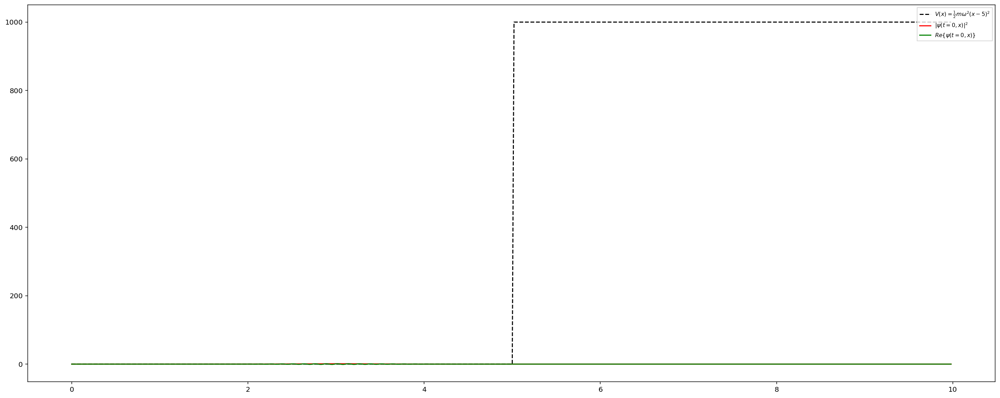

In [2]:
#discretization of the length (for solving laplace part)

dx = 0.02                 #seperation between two sections
x = np.arange(0, 10, dx)  #total number of points

# Defining the initial wave function

k_v = 50                 # wave vector
x_0 = 3.0                   # centre (or) peak of the initial wave packet
sigma = 0.5                 # wodth of the initial wave packet
m = 1                   # mass of the particle

psi_ini = np.sqrt((1.0 / (sigma * np.sqrt(np.pi)))) * np.exp(-1*(x - x_0)**2 / (2.0 * sigma**2)) * np.exp(1j * k_v * x)

# Defining potential

V_step = 1000     # Potentail is centre around x = 0

V = V = np.zeros(x.shape)
for i, _x in enumerate(x):
    if _x > 5:
        V[i] = V_step


# Initial plot of Probability density and Psi_ini
fig = plt.figure(figsize=(25, 10))
plt.plot(x, V, "k--", label= r"$V(x) = \frac{1}{2}m\omega^2 (x-5)^2$")
plt.plot(x, np.abs(psi_ini)**2, "r", label = r"$\vert\psi(t=0,x)\vert^2$")
plt.plot(x, np.real(psi_ini), "g", label=r"$Re\{\psi(t=0,x)\}$")
plt.legend(loc=1, fontsize=8, fancybox=False)
#print("Total Probability: ", np.sum(np.abs(psi_ini)**2)*dx)

In [3]:
D2 = sparse.diags([1, -2, 1], [-1, 0, 1], shape=(x.size, x.size)) / dx**2
D2.toarray() * dx**2

array([[-2.,  1.,  0., ...,  0.,  0.,  0.],
       [ 1., -2.,  1., ...,  0.,  0.,  0.],
       [ 0.,  1., -2., ...,  0.,  0.,  0.],
       ...,
       [ 0.,  0.,  0., ..., -2.,  1.,  0.],
       [ 0.,  0.,  0., ...,  1., -2.,  1.],
       [ 0.,  0.,  0., ...,  0.,  1., -2.]])

In [4]:
hbar = 1
# hbar = 1.0545718176461565e-34
def psi(t, psi):
    return -1j * (- 0.5 * hbar / m * D2.dot(psi) + V / hbar * psi)

In [5]:
# Solve the Initial Value Problem
dt = 0.001  # time interval for snapshots
t0 = 0.0    # initial time
tf = 0.2    # final time
t_eval = np.arange(t0, tf, dt)  # recorded time shots

print("Solving initial value problem")
sol = integrate.solve_ivp(psi, t_span=[t0, tf], y0=psi_ini, t_eval=t_eval, method="RK23")

Solving initial value problem


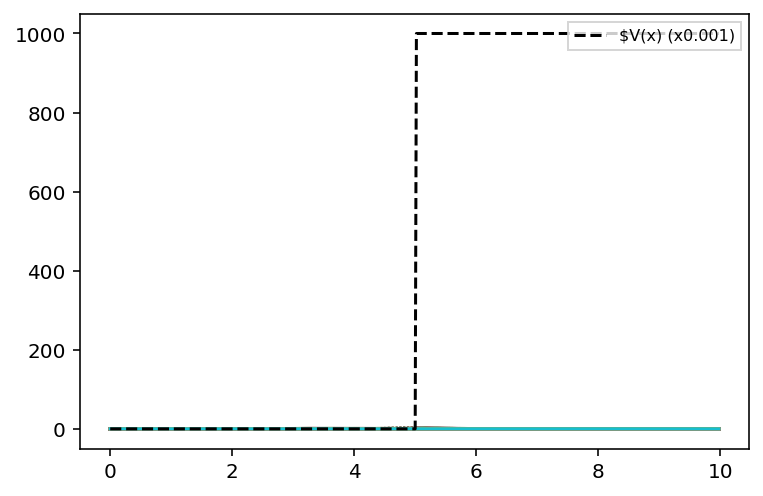

In [6]:

fig = plt.figure(figsize=(6, 4))
for i, t in enumerate(sol.t):
    plt.plot(x, np.abs(sol.y[:, i])**2)                  # Plot Wavefunctions
    #print("Total Prob. in frame", i, "=", np.sum(np.abs(sol.y[:, i])**2)*dx)   # Print Total Probability (Should = 1)
plt.plot(x, V , "k--", label=r"$V(x) (x0.001)")   # Plot Potential
plt.legend(loc=1, fontsize=8, fancybox=False)
#fig.savefig('step@2x.png')


Animation size has reached 21070546 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


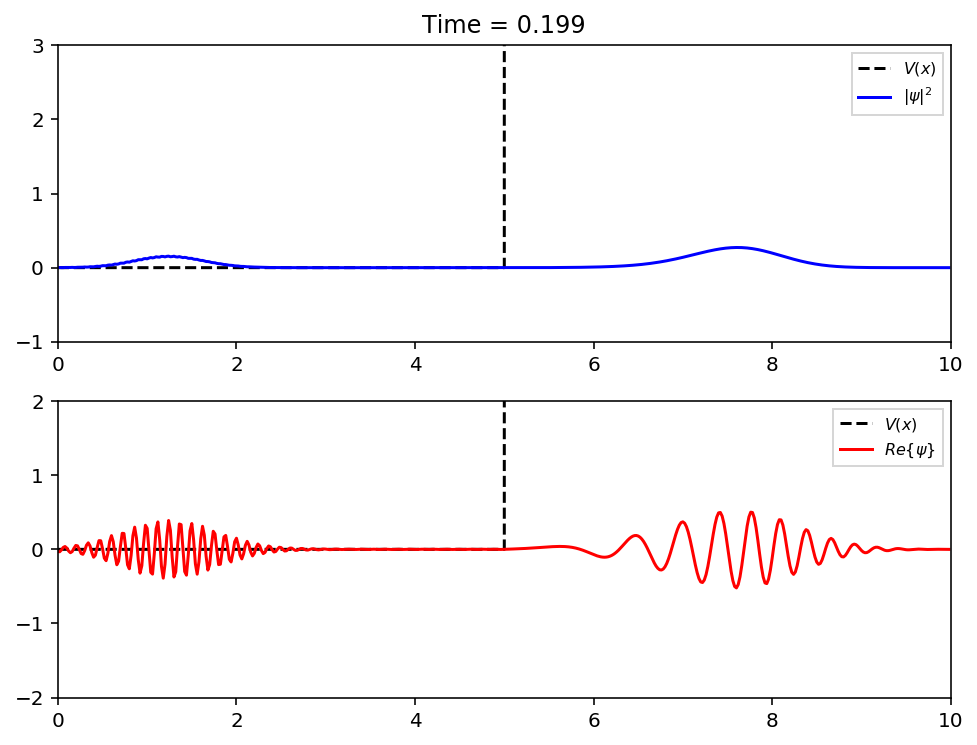

In [7]:
fig = plt.figure(figsize=(8, 6))

ax1 = plt.subplot(2, 1, 1)
ax1.set_xlim(0, 10)
ax1.set_ylim(-1, 3)
title = ax1.set_title('')
line11, = ax1.plot([], [], "k--", label=r"$V(x)$")
line12, = ax1.plot([], [], "b", label=r"$\vert \psi \vert^2$")
plt.legend(loc=1, fontsize=8, fancybox=False)

ax2 = plt.subplot(2, 1, 2)
ax2.set_xlim(0, 10)
ax2.set_ylim(-2, 2)
line21, = ax2.plot([], [], "k--", label=r"$V(x)$")
line22, = ax2.plot([], [], "r", label=r"$Re\{ \psi \}$")
plt.legend(loc=1, fontsize=8, fancybox=False)


def init():
    line11.set_data(x, V )
    line21.set_data(x, V )
    return line11, line21


def animate(i):
    line12.set_data(x, np.abs(sol.y[:, i])**2)
    line22.set_data(x, np.real(sol.y[:, i]))
    title.set_text('Time = {0:1.3f}'.format(sol.t[i]))
    return line12, line22


anim = animation.FuncAnimation(fig, animate, init_func=init,frames=len(sol.t), interval=200, blit=True)
HTML(anim.to_jshtml())